In [1]:
# Prepared by : 
# Roohollah Heidary ,Systems Risk and Reliability Analysis Lab, Risk and Reliability Center,
# Mechanical engineering dep., University of Maryland, College Park, MD, 20742
# (c) Copyright 2018

In [2]:
# In progress and is not final

In [3]:
# Subject     : Using Particle Filtering and hierarchical Bayesian method to to fuse ILI and OLI data

In [4]:
# Discription : this code is developed to fuse ILI and OLI data of corroded pipelines. At the beginning of the code, synthetic 
# data for internally corroded pipeline (real pit depth) are generated for a certain number of pits.
# I assumed that there are pit_No_ILI number of pits that are inspected by pigging (In_Line Inspection, ILI) 
# and pit_No_OLI number of pits are inspected by fixed online sensors.
# By adding measurement error to the sybthetic real pit depth, inspection data are generated.
# ILI data are exported to OpenBUGS to do hierarchical Bayesian (HB) analysis.
# The outputs of HB which are estimated pit depth for IL_Inspected pits are imported to this code.
# For OLI pit, I used Augmented Particle Filtering to estimate pit depth.
# Based on the estimated pit depth for ILI pits and OLI pit, the similairty index between each ILI pit and OLI pit is defined
# as the average of the ratio of the estimated pit depth of ILI pit by HB and estimated pit depth of OLI by APF.
# This similarity index is used to generate dummy observations for ILI and then these dummy observations are 
# used in APF for ILI pits to estimate pit depth for ILI pits.

In [155]:
from bokeh.plotting import figure, output_notebook, show
from bokeh.models import ColumnDataSource
from bokeh.io import push_notebook
from ipywidgets import interact
import pandas as pd
import numpy as np
import math
import time
# output to the IPython Notebook
output_notebook()
import warnings
warnings.filterwarnings('ignore')
from scipy.stats import norm
import bisect
from sklearn.neighbors.kde import KernelDensity
from scipy.stats import genextreme as gev
from scipy.stats import t
from scipy.stats import truncnorm
import scipy.stats as stats
from tqdm import tqdm_notebook as tqdm
import matplotlib.pyplot as plt




Loading BokehJS ...

In [6]:
# this function generate time steps given start, end and step size
def time_steps(low, up, step):
    length = ((up-low) / step)    
    length = int (length)
    return [low+i*step for i in range(length+1)]

In [7]:
# These are the input data of this analysis
# those parameters that are subject to change 
seed_number = 3987 # fixing seed number in random number generation 
excel_row = 29     # the number of row in the output file
pit_No_ILI = 100   # number of pits under ILI (In line inspection)
pit_No_OLI = 1     # number of pits under OLI (high frequency inspection)
ILI_time_step = 5.0                   # year, ILI interval
OLI_time_step = 0.1                   # year, OLI interval
growing_time_step = 0.1               # year, I assumed that each growing_time_step the pit grows randomly, modify it by PSWP

# the specific pit under OLI
pit_M_no = 1  

operation_start_time  = 1972          # the time that pipeline goes to operation 
first_inspection_time = 2000          # the time of the first inspection 
RUL_estimation_time   = 2100          # Remaining Useful Life estimation time 
change_time           = 2015          # The time at which operational conditions change


time_step_per_year = int (1/growing_time_step)
ILI_time = time_steps(first_inspection_time, RUL_estimation_time, ILI_time_step)
OLI_time = time_steps(first_inspection_time, RUL_estimation_time, OLI_time_step)
OLI_time = np.round (OLI_time, 2)
# number of available inspection data 
ILI_no = 4                  # Number of ILI operations, chosen based on available ILI data sets = len(OLI_time)
OLI_no = 200                # Number of OLI operations, chosen based on available OLI data sets = len(ILI_time). It is 
                            # assumed that OLI data are available at least up to the next ILI
                            # therefore it should be at least = (ILI_no) * int (ILI_time_step/OLI_time_step)  


# pipe geometries and material properties
outer_diameter = 506  # mm
PWT            = 8.41 # mm, pipe wall thickness
small_leak_threshold = 0.8 * PWT # 0.8 is the common value in the literature
ultimate_tensile_strength_mean = 456  # MPa
ultimate_tensile_strength_STD = ultimate_tensile_strength_mean * 0.03  # MPa
epsilon = 1
pit_length_mean = 15 # mm
pit_length_STD  = 3 # mm


# measurement error from zhang & zhou (2015) paper "System reliability of corroding pipelines considering stochastic
# process-based models for defect growth and internal pressure" y=a+bd+error
#a_ILI = (2.04/100 * PWT)
# at this stage I just considered random error, In the future I will consider biased error as well.
a_ILI = [2.04/100*PWT, 2.04/100*PWT, -15.28/100*PWT, -10.38/100*PWT] 
b_ILI = [0.97, 0.97, 1.4, 1.13]
#b_ILI = 1
ILI_percent_error = 5.97/100
ILI_error_STD = (ILI_percent_error * PWT)

a_OLI = 0
b_OLI = 1
OLI_percent_error = 2/100
OLI_error_STD = (OLI_percent_error * PWT)        

DOF = 50 # degree of freedom in t.student distribution for calculating variation in regression coefficients

In [8]:
# this part is added to have the same seed number in different parts of the code
select_random_seed = 1
if select_random_seed == 1 :
    np.random.seed(seed_number) # seed number is fixed to have the same random data at each random generation process 
else:
    np.random.seed()

In [9]:
#######################################################################
# generate random numbers from operational parameters distribution
#######################################################################
MCS_no = 10000
# coefficients of regression analysis based on :
# data from "Modelling the effects of production rates and physico-chemical parameters on pitting rate and pit depth growth
# of onshore oil and gas pipelines by Ossai, 2016" 
intercept_severe = 0.4400
nu_severe  = 0.8032

Pt_severe = np.random.gumbel (3.2704, 8.1274, MCS_no)     # Operating pressure
Log_Pt_Coef_severe = -0.0142
Pt_mean_severe = np.mean (Pt_severe)

# Python does not have two parameter weibull, I multiplied the 1 parameter weibull's results by the scale factor
Wt_severe = np.random.weibull (0.4847, MCS_no) * 94.9241  # Water production rate
Log_Wt_Coef_severe = -0.0076
Wt_mean_severe = np.mean (Wt_severe)

Ol_severe = np.random.weibull (2.1145, MCS_no) * 136.33   # Oil production rate
Log_Ol_Coef_severe = -.0002
Ol_mean_severe = np.mean (Ol_severe)

# be careful about order of scale and shape parameter of gumbel distribution in python
# in the original paper, extreme value distribution is used for Gs, Pt and pH, I used gumbel dist as an especial case of extreme
Gs_severe = np.random.gumbel (120120, 335310, MCS_no)     # Gas production rate
Log_Gs_Coef_severe = -0.04467
Gs_mean_severe = np.mean (Gs_severe)

r_severe = np.random.lognormal (3.447, 0.9151, MCS_no)    # Wall shear stress
Log_r_Coef_severe = 0.0037
r_mean_severe = np.mean (r_severe)

T_severe = np.random.lognormal (3.7296, 0.4052, MCS_no)   # Temperature 
Log_T_Coef_severe = 0.0370
T_mean_severe = np.mean (T_severe)

Pc_severe = np.random.weibull (1.2797 , MCS_no) * 0.1598  # CO2 Partial pressure
Log_Pc_Coef_severe = -0.0140
Pc_mean_severe = np.mean (Pc_severe)

S_severe = np.random.weibull (1.7117 , MCS_no) * 38.9576  # Sulphate ion
Log_S_Coef_severe = -0.0033
S_mean_severe = np.mean (S_severe)

C_severe = np.random.weibull (1.3 , MCS_no) * 3613.8      # Chloride ion
Log_C_Coef_severe = 0.0613
C_mean_severe = np.mean (C_severe)

W_severe = np.random.lognormal (-1.7178, 1.4696, MCS_no)  # Water cut 
Log_W_Coef_severe = 0.0420
W_mean_severe = np.mean (W_severe)

pH_severe = np.random.gumbel  (0.4747, 7.9418, MCS_no)    # pH
Log_pH_Coef_severe = -0.8446
pH_mean_severe = np.mean (pH_severe)

In [10]:

# for low gategory, I changed the parameters of the distributions to have approximately equal means that are given in the
# above-mentioned paper

# since a model for low category correlated with operational condition is not available in this paper, I changed the
# regression coefficients with a same ratio to have aproximately equal k for low category

severe_to_low_ratio = 1  # by trial and error to have closer k for low category

intercept_low = intercept_severe / severe_to_low_ratio
exponent_low  = 0.771   # from paper : "Predictive Modelling of Internal Pitting Corrosion of Aged Non-Piggable Pipelines"

Pt_low = np.random.gumbel (3.2704, 8.1274, MCS_no)     # Operating pressure
Log_Pt_Coef_low = Log_Pt_Coef_severe * severe_to_low_ratio
Pt_mean_low = np.mean (Pt_low)
Pt_STD_low = np.std (Pt_low)
#print('Pt')
#print(Pt_mean_low)
#print(Pt_STD_low)



# Python does not have two parameter weibull, I multiplied the 1 parameter weibull's results by the scale factor
Wt_low = np.random.weibull (0.4847, MCS_no) * 94.9241  # Water production rate
Log_Wt_Coef_low = Log_Wt_Coef_severe * severe_to_low_ratio
Wt_mean_low = np.mean (Wt_low)
Wt_STD_low = np.std (Wt_low)
#print('Wt')
#print(Wt_mean_low)
#print(Wt_STD_low)




Ol_low = np.random.weibull (2.1145, MCS_no) * 136.33   # Oil production rate
Log_Ol_Coef_low = Log_Ol_Coef_severe * severe_to_low_ratio
Ol_mean_low = np.mean (Ol_low)
Ol_STD_low = np.std (Ol_low)
#print('Ol')
#print(Ol_mean_low)
#print(Ol_STD_low)



# be careful about order of scale and shape parameter of gumbel distribution in python
# in the original paper, extreme value distribution is used for Gs, Pt and pH, I used gumbel dist as an especial case of extreme
Gs_low = np.random.gumbel (120120, 335310, MCS_no)     # Gas production rate
Log_Gs_Coef_low = Log_Gs_Coef_severe * severe_to_low_ratio
Gs_mean_low = np.mean (Gs_low)
Gs_STD_low = np.std (Gs_low)
#print('Gs')
#print(Gs_mean_low)
#print(Gs_STD_low)



r_low = np.random.lognormal (3.447, 0.9151, MCS_no)    # Wall shear stress
Log_r_Coef_low = Log_r_Coef_severe / severe_to_low_ratio
r_mean_low = np.mean (r_low)
r_STD_low = np.std (r_low)
#print('r')
#print(r_mean_low)
#print(r_STD_low)





T_low    = np.random.lognormal (3.39, 0.195, MCS_no)   # Temperature 
Log_T_Coef_low = Log_T_Coef_severe / severe_to_low_ratio
T_mean_low = np.mean (T_low)
T_STD_low = np.std(T_low)
#print('T')
#print(T_mean_low)
#print(T_STD_low)


Pc_low = np.random.weibull (1.5 , MCS_no) * 0.065  # CO2 Partial pressure
Log_Pc_Coef_low = Log_Pc_Coef_severe * severe_to_low_ratio
Pc_mean_low = np.mean (Pc_low)
Pc_STD_low = np.std (Pc_low)
#print('Pc')
#print(Pc_mean_low)
#print(Pc_STD_low)




S_low = np.random.weibull (1.47 , MCS_no) * 34.5  # Sulphate ion
Log_S_Coef_low = Log_S_Coef_severe * severe_to_low_ratio
S_mean_low = np.mean (S_low)
S_STD_low = np.std (S_low)
#print('S')
#print(S_mean_low)
#print(S_STD_low)


C_low = np.random.weibull (1.2 , MCS_no) * 1513.8      # Chloride ion
Log_C_Coef_low = Log_C_Coef_severe / severe_to_low_ratio
C_mean_low = np.mean (C_low)
C_STD_low = np.std (C_low)
#print('C')
#print(C_mean_low)
#print(C_STD_low)


W_low = np.random.lognormal (3.15, 0.9, MCS_no)  # Water cut 
Log_W_Coef_low = Log_W_Coef_severe / severe_to_low_ratio
W_mean_low = np.mean (W_low)
W_STD_low = np.std (W_low)
#print('W')
#print(W_mean_low)
#print(W_STD_low)


pH_low = np.random.weibull  (12.5, MCS_no) * 8    # pH
Log_pH_Coef_low = Log_pH_Coef_severe * severe_to_low_ratio
pH_mean_low = np.mean (pH_low)
pH_STD_low = np.std (pH_low)
#print('pH')
#print(pH_mean_low)
#print(pH_STD_low)


In [11]:
# for moderate gategory, I changed the parameters of the distributions to have approximately equal means and STDs that are given in the
# above-mentioned paper

# since a model for moderate category correlated with operational condition is not available in this paper, I changed the
# regression coefficients with a same ratio to have aproximately equal k for moderate category

severe_to_moderate_ratio = 2.2  # by trial and error to have closer k for moderate category

intercept_moderate = intercept_severe / severe_to_moderate_ratio
nu_moderate  = 0.7408   # from paper : "Predictive Modelling of Internal Pitting Corrosion of Aged Non-Piggable Pipelines"


In [12]:
Pt_moderate = np.random.gumbel (3.2704, 8.1274, MCS_no)     # Operating pressure
Log_Pt_Coef_moderate = Log_Pt_Coef_severe * severe_to_moderate_ratio
Pt_mean_moderate = np.mean (Pt_moderate)
Pt_STD_moderate = np.std (Pt_moderate)
#print('Pt')
#print(Pt_mean_moderate)
#print(Pt_STD_moderate)

# Python does not have two parameter weibull, I multiplied the 1 parameter weibull's results by the scale factor
Wt_moderate = np.random.weibull (0.4847, MCS_no) * 94.9241  # Water production rate
Log_Wt_Coef_moderate = Log_Wt_Coef_severe * severe_to_moderate_ratio
Wt_mean_moderate = np.mean (Wt_moderate)
Wt_STD_moderate = np.std (Wt_moderate)
#print('Wt')
#print(Wt_mean_moderate)
#print(Wt_STD_moderate)




Ol_moderate = np.random.weibull (2.1145, MCS_no) * 136.33   # Oil production rate
Log_Ol_Coef_moderate = Log_Ol_Coef_severe * severe_to_moderate_ratio
Ol_mean_moderate = np.mean (Ol_moderate)
Ol_STD_moderate = np.std (Ol_moderate)
#print('Ol')
#print(Ol_mean_moderate)
#print(Ol_STD_moderate)



# be careful about order of scale and shape parameter of gumbel distribution in python
# in the original paper, extreme value distribution is used for Gs, Pt and pH, I used gumbel dist as an especial case of extreme
Gs_moderate = np.random.gumbel (120120, 335310, MCS_no)     # Gas production rate
Log_Gs_Coef_moderate = Log_Gs_Coef_severe * severe_to_moderate_ratio
Gs_mean_moderate = np.mean (Gs_moderate)
Gs_STD_moderate = np.std (Gs_moderate)
#print('Gs')
#print(Gs_mean_moderate)
#print(Gs_STD_moderate)



r_moderate = np.random.lognormal (3.447, 0.9151, MCS_no)    # Wall shear stress
Log_r_Coef_moderate = Log_r_Coef_severe / severe_to_moderate_ratio
r_mean_moderate = np.mean (r_moderate)
r_STD_moderate = np.std (r_moderate)
#print('r')
#print(r_mean_moderate)
#print(r_STD_moderate)

In [13]:
T_moderate    = np.random.lognormal (3.35, 0.12, MCS_no)   # Temperature 
Log_T_Coef_moderate = Log_T_Coef_severe / severe_to_moderate_ratio
T_mean_moderate = np.mean (T_moderate)
T_STD_moderate = np.std(T_moderate)
#print('T')
#print(T_mean_moderate)
#print(T_STD_moderate)

In [14]:
Pc_moderate = np.random.weibull (1.25 , MCS_no) * 0.065  # CO2 Partial pressure
Log_Pc_Coef_moderate = Log_Pc_Coef_severe * severe_to_moderate_ratio
Pc_mean_moderate = np.mean (Pc_moderate)
Pc_STD_moderate = np.std (Pc_moderate)
#print('Pc')
#print(Pc_mean_moderate)
#print(Pc_STD_moderate)


In [15]:
S_moderate = np.random.weibull (1.5 , MCS_no) * 40.5  # Sulphate ion
Log_S_Coef_moderate = Log_S_Coef_severe * severe_to_moderate_ratio
S_mean_moderate = np.mean (S_moderate)
S_STD_moderate = np.std (S_moderate)
#print('S')
#print(S_mean_moderate)
#print(S_STD_moderate)


In [16]:
C_moderate = np.random.weibull (1.5 , MCS_no) * 1413.8      # Chloride ion
Log_C_Coef_moderate = Log_C_Coef_severe / severe_to_moderate_ratio
C_mean_moderate = np.mean (C_moderate)
C_STD_moderate = np.std (C_moderate)
#print('C')
#print(C_mean_moderate)
#print(C_STD_moderate)


In [17]:
W_moderate = np.random.lognormal (3.15, 0.8, MCS_no)  # Water cut 
Log_W_Coef_moderate = Log_W_Coef_severe / severe_to_moderate_ratio
W_mean_moderate = np.mean (W_moderate)
W_STD_moderate = np.std (W_moderate)
#print('W')
#print(W_mean_moderate)
#print(W_STD_moderate)

In [18]:
pH_moderate = np.random.weibull  (16.5, MCS_no) * 8.2    # pH
Log_pH_Coef_moderate = Log_pH_Coef_severe * severe_to_moderate_ratio
pH_mean_moderate = np.mean (pH_moderate)
pH_STD_moderate = np.std (pH_moderate)
#print('pH')
#print(pH_mean_moderate)
#print(pH_STD_moderate)

In [19]:
# calculating coefficient of power law model for moderate condition based on the original paper
def k_moderate (): 
    g1 = 0
    while g1 == 0:
        Pt_value  = np.random.gumbel (3.2704, 8.1274)
        if Pt_value > 0:
            g1 = 1
            
    g2 = 0
    while g2 == 0:
        Gs_value  = np.random.gumbel (120120, 335310)
        if Gs_value > 0:
            g2 = 1
            
    # generating truncated normal values:
    hh_lower = 0.025
    hh_upper = 0.975
    #hh_lower = 0
    #hh_upper = 0
    mean_value = 0
    STD_value = 1
    
    hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
                                loc=mean_value, scale=1, size = 1) #
    Log_Pt_Coef_moderate1 = Log_Pt_Coef_moderate + t.ppf(hh, DOF) * 0.0488  # 0.0488 is standard error
        
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) #
    Log_Wt_Coef_moderate1 = Log_Wt_Coef_moderate + t.ppf(hh, DOF) * 0.021
    
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) #
    Log_Ol_Coef_moderate1 = Log_Ol_Coef_moderate + t.ppf(hh, DOF) * 0.0657
    
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                          loc=mean_value, scale=1, size = 1) 
    Log_Gs_Coef_moderate1 = Log_Gs_Coef_moderate + t.ppf(hh, DOF) * 0.0554
    
   #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) 
    Log_r_Coef_moderate1 = Log_r_Coef_moderate + t.ppf(hh, DOF) * 0.0433
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                           loc=mean_value, scale=1, size = 1) #
    Log_T_Coef_moderate1 = Log_T_Coef_moderate + t.ppf(hh, DOF) * 0.083
    
   # hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_Pc_Coef_moderate1 = Log_Pc_Coef_moderate + t.ppf(hh, DOF) * 0.0373
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_S_Coef_moderate1 = Log_S_Coef_moderate + t.ppf(hh, DOF) * 0.0835
    
   # hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_C_Coef_moderate1 = Log_C_Coef_moderate + t.ppf(hh, DOF) * 0.0494
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_W_Coef_moderate1 = Log_W_Coef_moderate + t.ppf(hh, DOF) * 0.0337
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                           loc=mean_value, scale=1, size = 1) #
    Log_pH_Coef_moderate1 = Log_pH_Coef_moderate + t.ppf(hh, DOF) * 0.7418
   
    k_moderate = np.exp (intercept_moderate\
                       + Log_Pt_Coef_moderate1 * np.log10(Pt_value)\
                       + Log_Wt_Coef_moderate1 * np.log10((np.random.weibull (0.4847, 1) * 94.9241))\
                       + Log_Ol_Coef_moderate1 * np.log10((np.random.weibull (2.1145, 1) * 136.33))\
                       + Log_Gs_Coef_moderate1 * np.log10(Gs_value)\
                       + Log_r_Coef_moderate1  * np.log10(np.random.lognormal (3.447, 0.9151))\
                       + Log_T_Coef_moderate1  * np.log10(np.random.lognormal (3.35, 0.12))\
                       + Log_Pc_Coef_moderate1 * np.log10((np.random.weibull (1.25 , 1) * 0.065))\
                       + Log_S_Coef_moderate1  * np.log10((np.random.weibull (1.5 , 1) * 40.5))\
                       + Log_C_Coef_moderate1  * np.log10((np.random.weibull (1.5 , 1) * 1413.8)   )\
                       + Log_W_Coef_moderate1  * np.log10(np.random.lognormal (3.15, 0.8))\
                       + Log_pH_Coef_moderate1 * np.log10(np.random.weibull  (16.5, 1) * 8.2 ))    
    return k_moderate
k_moderate()

array([0.27475104])

In [20]:
# calculating coefficient of power law model for severe condition based on the original paper
def k_severe (): 
    g1 = 0
    while g1 == 0:
        Pt_value  = np.random.gumbel (3.2704, 8.1274)
        if Pt_value > 0:
            g1 = 1
            
    g2 = 0
    while g2 == 0:
        Gs_value  = np.random.gumbel (120120, 335310)
        if Gs_value > 0:
            g2 = 1
            
    # generating truncated normal values:
    hh_lower = 0.025
    hh_upper = 0.975
    mean_value = 0
    STD_value = 1
    
    hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
                                loc=mean_value, scale=1, size = 1) #
    Log_Pt_Coef_severe1 = Log_Pt_Coef_severe + t.ppf(hh, DOF) * 0.0488  # 0.0488 is standard error
        
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) #
    Log_Wt_Coef_severe1 = Log_Wt_Coef_severe + t.ppf(hh, DOF) * 0.021
    
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) #
    Log_Ol_Coef_severe1 = Log_Ol_Coef_severe + t.ppf(hh, DOF) * 0.0657
    
    #h  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                          loc=mean_value, scale=1, size = 1) 
    Log_Gs_Coef_severe1 = Log_Gs_Coef_severe + t.ppf(hh, DOF) * 0.0554
    
   #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                           loc=mean_value, scale=1, size = 1) 
    Log_r_Coef_severe1 = Log_r_Coef_severe + t.ppf(hh, DOF) * 0.0433
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                           loc=mean_value, scale=1, size = 1) #
    Log_T_Coef_severe1 = Log_T_Coef_severe + t.ppf(hh, DOF) * 0.083
    
   # hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_Pc_Coef_severe1 = Log_Pc_Coef_severe + t.ppf(hh, DOF) * 0.0373
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_S_Coef_severe1 = Log_S_Coef_severe + t.ppf(hh, DOF) * 0.0835
    
   # hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_C_Coef_severe1 = Log_C_Coef_severe + t.ppf(hh, DOF) * 0.0494
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
    #                            loc=mean_value, scale=1, size = 1) #
    Log_W_Coef_severe1 = Log_W_Coef_severe + t.ppf(hh, DOF) * 0.0337
    
    #hh  = stats.truncnorm.rvs((hh_lower - mean_value) / (STD_value), (hh_upper - mean_value) / (STD_value),\
     #                           loc=mean_value, scale=1, size = 1) #
    Log_pH_Coef_severe1 = Log_pH_Coef_severe + t.ppf(hh, DOF) * 0.7418
   
   
    
    
    k_severe = np.exp (intercept_severe\
                       + Log_Pt_Coef_severe1 * np.log10(Pt_value)\
                       + Log_Wt_Coef_severe1 * np.log10((np.random.weibull (0.4847, 1) * 94.9241))\
                       + Log_Ol_Coef_severe1 * np.log10((np.random.weibull (2.1145, 1) * 136.33))\
                       + Log_Gs_Coef_severe1 * np.log10(Gs_value)\
                       + Log_r_Coef_severe1  * np.log10(np.random.lognormal (3.447, 0.9151))\
                       + Log_T_Coef_severe1  * np.log10(np.random.lognormal (3.7296, 0.4052))\
                       + Log_Pc_Coef_severe1 * np.log10((np.random.weibull (1.2797 , 1) *0.1598))\
                       + Log_S_Coef_severe1  * np.log10((np.random.weibull (1.7117 , 1) * 38.9576))\
                       + Log_C_Coef_severe1  * np.log10((np.random.weibull (1.3 , 1) * 3613.8))\
                       + Log_W_Coef_severe1  * np.log10(np.random.lognormal (-1.7178, 1.4696))\
                       + Log_pH_Coef_severe1 * np.log10(np.random.weibull  (0.4747, 1) * 7.9418 ))   
    return k_severe
k_severe ()

array([1.1254129])

In [21]:
## corrosion growth models
t0 = operation_start_time             # corrosion initiation time, TODO : shoude be estimated for each pit 
nu_low = exponent_low        
normal_process_error_SD = 0.5

## generating real depth growing times, modify this part by PSWP later
growing_time = np.zeros ((RUL_estimation_time - operation_start_time) * time_step_per_year+1)
nu =  np.zeros_like(growing_time)

#  k_ILI is the matix that rows indicate the number of ILI pits and columns indicate the time steps
k_ILI = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range((RUL_estimation_time - operation_start_time)\
                                                                       *time_step_per_year+1)).astype(float)

#  k_OLI is the matix that rows indicate the number of OLI pits and columns indicate the time steps
k_OLI = pd.DataFrame(0, index=range(1,pit_No_OLI+1), columns=range((RUL_estimation_time - operation_start_time)\
                                                                       *time_step_per_year+1)).astype(float)

# in this loop, growing times are defined and k_ILI and k_OLI values are generated for each pit and each time step
for j in range(0, (RUL_estimation_time - operation_start_time) * time_step_per_year+1):
    growing_time[j] = operation_start_time  + j / time_step_per_year 

    if growing_time[j] <= change_time: 
        nu[j] = nu_moderate
        for i in range (1, pit_No_ILI+1): 
                check_nan = 0
                while check_nan == 0:
                    k = k_moderate ()
                    if k > 0 and k < 1:
                        check_nan = 1
                        k_ILI.loc[i][j] = k


        for i in range (1, pit_No_OLI+1): 
            check_nan = 0
            while check_nan == 0:                
                k = k_moderate ()
                if k > 0 and k < 1:
                    check_nan = 1
                    k_OLI.loc[i][j] = k  
    else:
        nu[j] = nu_severe
        for i in range (1, pit_No_ILI+1): 
                check_nan = 0
                while check_nan == 0:
                    k = k_severe ()
                    if k > 0 and k < 1:
                        check_nan = 1
                        k_ILI.loc[i][j] = k


        for i in range (1, pit_No_OLI+1): 
            check_nan = 0
            while check_nan == 0:                
                k = k_severe ()
                if k > 0 and k < 1:
                    check_nan = 1
                    k_OLI.loc[i][j] = k  
                    
# the seed number command should be repeared here bcz in calculating k, some generated numbers are nan and 
# a new one was genearted and therefore the seed random generation process changes  
if select_random_seed == 1 :
    np.random.seed(seed_number) # seed number is fixed to have the same random data at each random generation process 
else:
    np.random.seed()

#################################################################################################################                  
## generate real and measured data
# dataframe of real depth of those pits that are inspected by ILI:
pit_depth_ILI = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(growing_time))).astype(float)
# dataframe of increment of real depth of those pits that are inspected by ILI:
pit_depth_ILI_increment = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(growing_time)-1)).astype(float)
# dataframe of real depth of those pits that are inspected by OLI:
pit_depth_OLI = pd.DataFrame(0, index=range(1,pit_No_OLI+1), columns=range(len(growing_time))).astype(float)
# dataframe of measured depth of those pits that are inspected by ILI:
ILI_data = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(ILI_time))).astype(float)
# dataframe of measured depth of those pits that are inspected by OLI:
OLI_data = pd.DataFrame(0, index=range(1,pit_No_OLI+1), columns=range(len(OLI_time))).astype(float)
# dataframe of dummy observation for those pits that are inspected by ILI:
dummy_data = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(int(ILI_time_step / OLI_time_step)))\
.astype(float)
# dataframe of approximate real time to failure of ILI pits
approx_TTF = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(1)).astype(float)
k_ILI_fix = 0.25
## generating real depth and measurements for ILI and OLI pits
# these pits are under ILI 
change_coef = 2.5

for i in range (1, pit_No_ILI+1):    
    jj = 0
    ff = 0
    """for j in range (1, len(growing_time)): 
        if growing_time[j] <= change_time:            
            pit_depth_ILI.loc[i][j] = pit_depth_ILI.loc[i][j-1] + k_ILI.loc[i][j] *nu_moderate*(growing_time[j] - t0)\
            **(nu_low-1)*growing_time_step#*np.exp(np.random.normal(0,normal_process_error_SD))        
                   
            if pit_depth_ILI.loc[i][j] > small_leak_threshold and ff == 0:
                approx_TTF.loc[i] = growing_time[j]
                ff = 1
        else :        
            pit_depth_ILI.loc[i][j] = pit_depth_ILI.loc[i][j-1] + change_coef * k_ILI.loc[i][j] *nu_severe*(growing_time[j] - t0)\
            **(nu_low-1)*growing_time_step#*np.exp(np.random.normal(0,normal_process_error_SD))         
                
            if pit_depth_ILI.loc[i][j] > small_leak_threshold and ff == 0:
                approx_TTF.loc[i] = growing_time[j]
                ff = 1

        if growing_time[j] == ILI_time[jj]:
            if jj < ILI_no:
                ILI_data.loc[i][jj] = a_ILI[jj] + b_ILI[jj] * pit_depth_ILI.loc[i][j] + np.random.normal (0,ILI_error_STD )
                jj = jj + 1
"""
    for j in range (1, len(growing_time)): 
        pit_depth_ILI.loc[i][j] = pit_depth_ILI.loc[i][j-1] + k_ILI.loc[i][j] *nu[j]*(growing_time[j] - t0)\
        **(nu_low-1)*growing_time_step#*np.exp(np.random.normal(0,normal_process_error_SD))        
                   
        if pit_depth_ILI.loc[i][j] > small_leak_threshold and ff == 0:
            approx_TTF.loc[i] = growing_time[j]
            ff = 1
        
        

        if growing_time[j] == ILI_time[jj]:
                if jj < ILI_no:
                    ILI_data.loc[i][jj] = a_ILI[jj] + b_ILI[jj] * pit_depth_ILI.loc[i][j] + np.random.normal (0,ILI_error_STD )
                    jj = jj + 1

# these pits are under OLI 
"""
for i in range (1, pit_No_OLI+1):
    jj = 0
    for j in range (1, len(growing_time)):
        if growing_time[j] <= change_time:            
            pit_depth_OLI.loc[i][j] = pit_depth_OLI.loc[i][j-1] + k_OLI.loc[i][j]  *nu_moderate*(growing_time[j] - t0)\
            **(nu_low-1)*growing_time_step #*np.exp(np.random.normal(0,normal_process_error_SD)) 
        else:
            pit_depth_OLI.loc[i][j] = pit_depth_OLI.loc[i][j-1] + change_coef * k_OLI.loc[i][j]  *nu_severe*(growing_time[j] - t0)\
            **(nu_low-1)*growing_time_step #*np.exp(np.random.normal(0,normal_process_error_SD)) 

        
        
        if growing_time[j] == OLI_time[jj]: 
            OLI_data.loc[i][jj] = a_OLI + b_OLI * pit_depth_OLI.loc[i][j] + np.random.normal (0,OLI_error_STD)
            jj = jj + 1
"""

for i in range (1, pit_No_OLI+1):
    jj = 0
    for j in range (1, len(growing_time)):
        pit_depth_OLI.loc[i][j] = pit_depth_OLI.loc[i][j-1] + k_OLI.loc[i][j]  *nu[j]*(growing_time[j] - t0)\
        **(nu_low-1)*growing_time_step #*np.exp(np.random.normal(0,normal_process_error_SD)) 

        if growing_time[j] == OLI_time[jj]: 
            OLI_data.loc[i][jj] = a_OLI + b_OLI * pit_depth_OLI.loc[i][j] + np.random.normal (0,OLI_error_STD)
            jj = jj + 1

for j in range (1, len(growing_time)):
    pit_depth_ILI_increment[j] = pit_depth_ILI[j] - pit_depth_ILI[j-1]



In [22]:
STD_Of_Synthetic_data = np.mean(np.std(pit_depth_ILI_increment))


In [23]:
## available ILI and OLI data
avail_ILI_data = ILI_data.loc [:, 0:ILI_no-1]
avail_OLI_data = OLI_data.loc [:, 0:OLI_no]

In [24]:
###########################################################################################  
# plots
p = figure(title = 'Distributions are modified for moderate category, The regression coeff.s are divided by 1.7'   , x_axis_label='t (year)', y_axis_label='depth (mm)', plot_height = 700, plot_width = 700)
for i in range(1, pit_No_ILI+1):
    p.line(growing_time, pit_depth_ILI.loc [i] , legend ='Real depth ', color = 'red')
    p.circle(ILI_time[0:ILI_no+1 ],avail_ILI_data.loc [i] ,radius=0.2,legend ='Observed depth by ILI',color = 'red')         

p.circle(OLI_time, avail_OLI_data.loc [pit_M_no] , radius=0.2, legend ='Observed depth by OLI', color = 'green')
p.line(growing_time, pit_depth_OLI.loc [pit_M_no] , line_width=2, legend ='Real depth of pit M', color = 'green')
p.line(growing_time, small_leak_threshold , line_width=2, legend ='small_leak_threshold', color = 'blue')
p.legend.location='top_left'  
show(p)

In [25]:
###########################################################################################  
# plots


for i in range(1, pit_No_ILI+1):
    p = figure(title = 'Pit No.' + str (i)   , x_axis_label='t (year)', y_axis_label='Pit depth (mm)', plot_height = 700, plot_width = 700)
    p.xaxis.axis_line_width = 3
    p.xaxis.major_label_text_font_size = "15pt"
    p.yaxis.axis_line_width = 3 
    p.yaxis.major_label_text_font_size = "15pt"
    p.xaxis.axis_label_text_font_size  = "20pt"
    p.yaxis.axis_label_text_font_size  = "20pt"
    p.axis.minor_tick_in  = 2
    p.axis.minor_tick_out = 5
    p.axis.axis_label_text_alpha=0.9
    p.legend.label_text_font_size = "20pt"
    p.line(growing_time, pit_depth_ILI.loc [i] , legend ='Real depth ',line_width=2, color = 'red')
    p.circle(ILI_time[0:ILI_no+1 ],avail_ILI_data.loc [i] ,radius=0.5,legend ='Observed depth by ILI',color = 'red')         
    p.line(growing_time, pit_depth_OLI.loc [pit_M_no] , line_width=2, legend ='Real depth of pit M', color = 'green')
    p.circle(OLI_time, avail_OLI_data.loc [pit_M_no] , radius=0.2, legend ='Observed depth by OLI', color = 'green')
    #p.line(growing_time, small_leak_threshold , line_width=2, legend ='small_leak_threshold', color = 'blue')
    p.legend.location='top_left'  
    show(p)

In [26]:
###########################################################################################  
# plots
p = figure(title = 'Comaprison between synthetic data for moderate category and Ossai paper' , x_axis_label='t (year)', y_axis_label='depth (mm)', plot_height = 700, plot_width = 700)
#p.line(growing_time, pit_depth_ILI.loc [49] , legend ='Real depth ', color = 'red')
#p.line(growing_time, pit_depth_ILI.loc [90] , legend ='Real depth ', color = 'red')
p.line(growing_time, pit_depth_OLI.loc [pit_M_no] , line_width=2, legend ='Synthetic data for pit M', color = 'green')
#p.line(growing_time, 0.129*(growing_time-1972)**0.8699 , line_width=2, legend ='Real depth of pit M', color = 'blue')
#p.line(growing_time, 0.2428*(growing_time-1972)**0.7648 , line_width=2, legend ='Real depth of pit M', color = 'blue')
p.line(growing_time, small_leak_threshold , line_width=2, legend ='small_leak_threshold', color = 'blue')

p.line(growing_time, 0.12*(growing_time-1972)**0.771 , line_width=2, line_dash = 'dashed', legend ='low', color = 'black')
p.line(growing_time, 0.2687*(growing_time-1972)**0.7408 , line_width=2, line_dash = 'dashed', legend ='moderate', color = 'blue')
p.line(growing_time, 0.3887*(growing_time-1972)**0.7879 , line_width=2, line_dash = 'dashed', legend ='high', color = 'orange')
p.line(growing_time, 0.6508*(growing_time-1972)**0.8657 , line_width=2, line_dash = 'dashed', legend ='severe', color = 'green')
p.line(growing_time, 0.695*(growing_time-1972)**0.7639 , line_width=2, line_dash = 'dashed', legend ='all', color = 'red')



p.legend.location='top_left'  
show(p)

In [27]:
#### Export these data to OpenBUGS and return back the estimation of heirarchical Bayesian for the next steps

In [28]:
pd.DataFrame(avail_ILI_data / PWT * 100).to_csv('avail_ILI_data_seed_'+str(seed_number)+ ' moderate .csv',header=False, index=False, float_format='%.2f')

In [29]:
estimated_mean_depth_HB = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(1, ILI_no+2)).astype(float)
estimated_depth_STD_HB  = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(1,ILI_no+2)).astype(float)

# HB : hierarchical Bayesian
# depthHB- seed no.xlsx is generated in OpenBUGS and is imported here
k=0
for i in range(1, pit_No_ILI+1): 
    for j in range(1,ILI_no+2):
        estimated_mean_depth_HB.loc[i][j]=pd.read_excel('depthHB- seed '+str(seed_number)+'_moderate.xlsx', sheetname='mean').loc[k]/100*PWT # reads estimated depth by HB in OpenBugs
        estimated_depth_STD_HB.loc[i][j] =pd.read_excel('depthHB- seed '+str(seed_number)+'_moderate.xlsx', sheetname='STD').loc[k]/100*PWT # reads estimated depth by HB in OpenBugs
        k=k+1

In [30]:
estimated_mean_depth_HB.head()

,1,2,3,4,5
1,2.279951,2.579347,2.927521,3.249624,3.496037
2,2.824078,3.125156,3.443895,3.716379,3.996432
3,2.142868,2.378348,2.687836,2.945182,3.169729
4,2.262290,2.499452,2.708861,2.900609,3.121792
5,2.458243,2.698769,2.951069,3.202528,3.445577


In [31]:
# calculating the root mean square
from sklearn.metrics import mean_squared_error
from math import sqrt
Estimation_time_index = int((first_inspection_time + OLI_no*OLI_time_step -operation_start_time)/growing_time_step-1)+1
#Estimation_time_index = 96
rms_HB = sqrt(mean_squared_error(pit_depth_ILI.loc[:,Estimation_time_index],\
                              estimated_mean_depth_HB.loc [:,ILI_no+1]))
rms_HB

0.5187195623982178

In [32]:
Estimation_time_index

480

In [33]:
growing_time[96]

1981.6

In [34]:
pit_depth_ILI.loc[:,Estimation_time_index].head()

1    4.333598
2    4.060373
3    3.851935
4    3.870455
5    3.818135
Name: 480, dtype: float64

In [35]:
# this function is for plotting the results of the particle filtering method
def show_particles():
    p = figure(title = 'Augmented PF, Particles state at', x_axis_label='t (year)', y_axis_label='depth (mm)',\
               plot_height = 700, plot_width = 700)
    # pit M
    p.line(growing_time, pit_depth_OLI.loc [pit_M_no] , legend ='Real depth, pit M', color = 'green')
    p.triangle(OLI_time [:OLI_no], avail_OLI_data.loc [pit_M_no], size=5, legend ='OLI  for pit M', color = 'green')
    # pit x
    p.circle(p_data.data['t'], p_data.data['y'], legend ='Particles state', radius=0.2, alpha = 0.5, color = 'black')    
    #p.circle(ILI_time[0:ILI_no ],estimated_mean_depth_HB.loc [i] ,radius=0.2,legend ='Estimated depth by HB',color = 'blue')         
    #p.circle(ILI_time[0:ILI_no ],estimated_mean_depth_HB.loc [i]  + estimated_depth_STD_HB.loc [i]*3 ,radius=0.2,\
    #         legend ='Mean HB + 3*STD',color = 'red')         
    #p.circle(ILI_time[0:ILI_no ],estimated_mean_depth_HB.loc [i]  - estimated_depth_STD_HB.loc [i]*3 ,radius=0.2,\
    #         legend ='Mean HB - 3*STD',color = 'red')         

    p.legend.location='top_left'
    handle = show(p, notebook_handle=True)
    return handle

In [36]:
# Initialize particles for state (depth) of each particle:
def initial_condition (prior_k_p, prior_nu_p):
    P = np.random.normal(3, 1, size = num_particles) # our belief about Particle states  
    all_particle_OLI_time[:,0] = P
    # Initialize particles for model parameters of each particle:
    k_p  = np.random.normal(prior_k_p, 0.1, size = num_particles) 
    nu_p = np.random.normal(prior_nu_p, 0.1, size = num_particles) 
    k_p_mean = np.mean(k_p)
    nu_p_mean = np.mean(nu_p)
    k_p_var = np.var(k_p)
    nu_p_var = np.var(nu_p)
    # Particle weights: at the begining it is assumed that all particles have equal weight = 1
    w = np.ones(len(P)) 
    p_data = ColumnDataSource(data=dict(t=np.full(P.shape,operation_start_time),y=P))    
    return P,all_particle_OLI_time,k_p,nu_p,k_p_mean,nu_p_mean, k_p_var, nu_p_var, w, p_data#, TTF, TTF_is_calculated

In [37]:
# calculating kernel location for each particle
def kernel_location (): 
    m_k  = (1 - h**2)**0.5 * k_p + (1 - (1 - h**2)**0.5) * k_p_mean
    m_nu = (1 - h**2)**0.5 * nu_p + (1 - (1 -h**2)**0.5) * nu_p_mean  
    return m_k, m_nu 

In [38]:
# Recalculate weights: based on observations the weight of each particle is changing in each update

# see https://en.wikipedia.org/wiki/Kernel_density_estimation for kernel density
# and http://scikit-learn.org/stable/auto_examples/neighbors/plot_kde_1d.html
kde = KernelDensity(bandwidth = 0.2, kernel = 'gaussian', algorithm = 'ball_tree')
# nprob gives pdf of a normal distribution with mean =p for random variable t, scale (STD) is predifined in this function
nprob = lambda p,t: norm.pdf(t, loc=p, scale = OLI_error_STD) 
# resample is a function that change the state of particles based on a new observation
def resample(P, k_p, nu_p, obs):
    # Particle_State : our belief about particle state
    # enumerate function: goes simultaneously over sequence's index and values        
    # finding the likelihihood of Particle_State being the true value based on the observations
    for i,Particle_State in enumerate(P):
        w[i] = nprob(obs, Particle_State)  # given the observation and current state of the particle, the new weight is 
                                           # calculated from pdf of normal distribution
    w_norm  = np.sum(w)                    # summation of all weights
    w_ecdf = np.cumsum(w)/w_norm           # cdf of weights   
    # Resample the points
    P_new = np.empty_like(P)   
    k_p_new = np.empty_like(P)   
    nu_p_new = np.empty_like(P)   
    for i,Particle_State in enumerate(P):
        UnifRand=np.random.uniform(0, 1)
        index = bisect.bisect_left(w_ecdf, UnifRand) # this function finds the location of UnifRand (a uniform random number)
        # in the weight CDF (w_ecdf) and based on this index resamples from P vector, therefore the most dense area of the \
        # distribution of the particles is more selected
        P_new[i] = P[index]    
        k_p_new[i] = k_p[index]    
        nu_p_new[i] = nu_p[index]    
    # Regularize it!
    kde.fit(P_new[:,np.newaxis])         
    #return kde.sample(num_particles).flatten()
    return P_new, k_p_new, nu_p_new

#show_particles()

In [39]:
# Advance the Dynamics Model:
# in this step, each particle is moved based on the process model
def move(P,i,inspection_times,time_step): # i is the time index     
    #P += k_p * nu_p * (inspection_times[i] - t0)**(nu_p - 1) * time_step#*np.exp(np.random.normal(0,0.005, size = num_particles))  
    P += k_p * nu_p * (inspection_times[i] - t0)**(nu_p - 1) * time_step + np.random.normal(0, state_noise_STD, size = num_particles)     
    return P

In [40]:
# APF for pit M
np.random.seed(seed_number)
start_time = time.time()
num_particles = 10000          # Number of particle in particle filtering method
state_noise_STD = STD_Of_Synthetic_data
h  = 0.01         # h is the smooting variable in augmented particle filtering,    
all_particle_OLI_time = np.zeros((num_particles,len(OLI_time)))# this matrix contains the state of all particles at all OLI times
degradation_level = pd.DataFrame(0, index=range(0, len(OLI_time)), columns=range(3)).astype(float)
degradation_level.columns = ['minDegr', 'maxDegr', 'meanDegr']
model_parameters = pd.DataFrame(0, index=range(0, OLI_no+1), columns=range(2)).astype(float)
model_parameters.columns = ['mean_k', 'mean_nu']

mean_estimated_depth_OLI_M = np.zeros(len(OLI_time))
TTF = pd.DataFrame(0, index=range(0, num_particles), columns=range(1)).astype(float)
TTF_is_calculated = pd.DataFrame(False, index=range(0, num_particles), columns=range(1)).astype(bool)
P, all_particle_OLI_time, k_p, nu_p, k_p_mean, nu_p_mean, k_p_var, nu_p_var,  w, p_data, = initial_condition (0.1, 0.6)
mean_estimated_depth_OLI_M[0] = np.average(P)
Accepted_Probability_of_failure = 60
k_1 = 0
k_2 = 0
k_3 = 0
jj  = 0
for j in range(0, OLI_no+1):
    k_p, nu_p = kernel_location ()    
    P = move(P,j,OLI_time,OLI_time_step)   
    k_p  = k_p  + np.random.normal(0, h**2 * k_p_var)    # size of random generation is given in m_k dimension that is num_particles
    nu_p = nu_p + np.random.normal(0, h**2 * nu_p_var) 
    #print('after move')
    p_data.data['t'] = np.full(P.shape,OLI_time[j])
    p_data.data['y'] = P          
    #show_particles()
    P, k_p, nu_p = resample(P, k_p, nu_p, avail_OLI_data.loc[pit_M_no][j])
    k_p_mean = np.mean (k_p)
    k_p_var = np.var(k_p)    
    nu_p_mean = np.mean (nu_p)         
    nu_p_var = np.var(nu_p)
    #print('after resampling')
    p_data.data['t'] = np.full(P.shape,OLI_time[j])
    p_data.data['y'] = P            
    model_parameters.mean_k [j]  = k_p_mean
    model_parameters.mean_nu [j] = nu_p_mean

    # Get the mean:
    mean_estimated_depth_OLI_M[j] = np.average(P)
    #push_notebook(handle=t)
    time.sleep(0.01)
    #for k in range(0, num_particles):
    #    if P[k] >= small_leak_threshold and TTF_is_calculated.iloc[k].bool() == False:
        #if P[k] > 4 :
     #       TTF_is_calculated.iloc [k] = True
     #       TTF.iloc[k] = OLI_time[j]
    
    if np.percentile(P, Accepted_Probability_of_failure) > small_leak_threshold and k_1 == 0:
        k_1 = 1
        K_3 = 1
    all_particle_OLI_time[:,j]    = P
    degradation_level.minDegr[j]  = np.min(P)
    degradation_level.maxDegr[j]  = np.max(P)
    degradation_level.meanDegr[j] = np.mean(P)
    
    #if np.percentile(P, 50) > small_leak_threshold:
     #   print (OLI_time[j])       
    #show_particles()     


# Prediction phase for pit M
# moving particles is done in this step for prediction without updating the weights of particles bcz there is no observations
for j in range(OLI_no , len(OLI_time)):
    P = move(P,j,OLI_time,OLI_time_step)  
    p_data.data['t'] = np.full(P.shape,OLI_time[j])
    p_data.data['y'] = P 
    # Get the mean:
    mean_estimated_depth_OLI_M[j] = np.average(P)
    #push_notebook(handle=t)
    time.sleep(0.05)
    #for k in range(0, num_particles):
    #    if P[k] >= small_leak_threshold and TTF_is_calculated.iloc[k].bool() == False:
    ##        TTF_is_calculated.iloc [k] = True
    #        TTF.iloc[k] = OLI_time[j]
    if np.percentile(P, Accepted_Probability_of_failure) > small_leak_threshold and k_2 == 0 and k_3 == 0:
        k_2 = 1
    all_particle_OLI_time[:,j] = P
    degradation_level.minDegr[j] = np.min(P)
    degradation_level.maxDegr[j] = np.max(P)
    degradation_level.meanDegr[j] = np.mean(P)
    #if np.percentile(P, 50) > small_leak_threshold:
     #   print (OLI_time[j])
    #if j > len(OLI_time) - 20:
    #show_particles()
elapsed_time = time.time() - start_time    
elapsed_time

237.68844175338745

In [41]:
p2 = figure(title = 'h = ' + str(h) + ', Prtcl.No = '+ str(num_particles)+', State noise STD = ' + str(state_noise_STD)\
            + '', x_axis_label='t (year)', y_axis_label='model parameters'\
            , plot_height = 700, plot_width = 700)
p2.line(OLI_time[:OLI_no+1], model_parameters.mean_nu[:OLI_no+1], color = 'blue', legend = 'nu')
p2.line(OLI_time[:OLI_no+1], model_parameters.mean_k[:OLI_no+1], color = 'red', legend = 'k')
p2.legend.location ='top_left'
show(p2)

In [42]:
p1 = figure(title = 'h = ' + str(h) + ', Prtcl.No = '+ str(num_particles)+', State noise STD = ' + str(state_noise_STD), x_axis_label='t (year)', y_axis_label='depth (mm)'\
            , plot_height = 700, plot_width = 700)
p1.xaxis.axis_line_width = 3
p1.yaxis.axis_line_width = 3
p1.xaxis.axis_label_text_font_size = "13pt"
p1.yaxis.axis_label_text_font_size = "13pt"
p1.axis.minor_tick_in = 2
p1.axis.minor_tick_out = 5
p1.axis.axis_label_text_alpha = 0.9

#p1.line(growing_time, pit_depth_OLI.iloc [pit_M_no] , legend ='Simulated pit depth growing for a single pit', color = 'red')
#p1.triangle(OLI_time [:OLI_no], avail_OLI_data.loc[pit_M_no], size=5, legend ='OLI  for pit M', color = 'green')
p1.line(growing_time, pit_depth_OLI.loc[pit_M_no] , legend ='Real depth of pit M', color = 'green')

#p1.circle(OLI_time, mean_estimated_depth_OLI_M, radius=0.2, alpha = 0.2, color = 'blue', legend = 'Mean estimated depth for pit M by APF')
#for j in range(0 , len(OLI_time)):
#    p1.circle(OLI_time[j], all_particle_OLI_time[:,j], radius=0.2, alpha = 0.2, color = 'blue', legend = 'particles')

#p1.circle(OLI_time[0], all_particle_OLI_time[:,0], radius=0.2, alpha = 0.2, color = 'blue', legend = 'Mean estimated depth for pit M by APF')
p1.line(OLI_time, degradation_level.minDegr, color = 'red', legend = 'Minimum estimated depth')
p1.line(OLI_time, degradation_level.maxDegr, color = 'red', legend = 'Maximum estimated depth')
p1.line(OLI_time, degradation_level.meanDegr, color = 'purple', legend = 'Mean estimated depth')
p1.legend.location ='top_left'
show(p1)


In [43]:
pd.DataFrame(model_parameters.mean_nu).hist()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001D36B5792B0>]],
      dtype=object)

In [88]:
def PosNormal(mean, sigma):
    x = np.random.normal(mean,sigma)
    return(x if x>=0 else PosNormal(mean,sigma))

In [135]:
Operating_pressure_mean = 6.66       # MPa
Operating_pressure_STD  = Operating_pressure_mean * 0.02 # MPa
# Calculating probability of small leak at each time
prob_of_failure = pd.DataFrame(0, index=range(0, len(OLI_time)), columns=range(4)).astype(float)
prob_of_failure.columns = ["Safe", "Small Leak", "Large Leak", "Rupture"]
OperPressSamples = pd.DataFrame(0, index=range(0, num_particles), columns=range(len(OLI_time))).astype(float)
BurstPressSamples = pd.DataFrame(0, index=range(0, num_particles), columns=range(len(OLI_time))).astype(float)
RupturePressSamples = pd.DataFrame(0, index=range(0, num_particles), columns=range(len(OLI_time))).astype(float)
PWTSamples = pd.DataFrame(0, index=range(0, num_particles), columns=range(len(OLI_time))).astype(float)


for j in range(0,len(OLI_time)):
    N_small   = 0
    N_large   = 0
    N_rupture = 0
    for k in range(0, num_particles):       
        pit_length = np.random.normal(pit_length_mean, pit_length_STD)
        UTS = np.random.normal(ultimate_tensile_strength_mean, ultimate_tensile_strength_STD)
        Op_pressure = np.random.normal (Operating_pressure_mean, Operating_pressure_STD)
        PWTSample = np.random.normal (Operating_pressure_mean, Operating_pressure_STD)
        # burst pressure
        Pb = epsilon * UTS * PWTSample / outer_diameter * (1 - all_particle_OLI_time[k, j] / PWTSample *\
            (1- np.exp(-0.157 * pit_length / np.sqrt(outer_diameter*(PWTSample - all_particle_OLI_time[k, j]) / 2))))
        if pit_length**2 / (outer_diameter * PWTSample) <= 50:
            M = np.sqrt(1+0.6275 * pit_length**2/(outer_diameter * PWTSample)-0.003375*pit_length**4 \
                        / (outer_diameter * PWTSample)**2)
        else:
            M =  3.3 + 0.032 * pit_length**2/(outer_diameter * PWTSample) 
        P_rupture = 2 * PWTSample * 0.9 * UTS / (M * outer_diameter)
        #print (Pb)
        #print (P_rupture)
        #print (Op_pressure)
        OperPressSamples.loc[k,j] = Op_pressure
        BurstPressSamples.loc[k,j] = Pb
        RupturePressSamples.loc[k,j] = P_rupture
        PWTSamples.loc[k,j] = PWTSample
        f1 = small_leak_threshold - all_particle_OLI_time[k, j]
        f2 = Pb - Op_pressure
        f3 = P_rupture - Op_pressure
        if f1 <= 0 :#and f2 > 0:
            N_small  = N_small + 1
        if f1 > 0 and f2 <= 0 and f3 > 0:
            N_large  = N_large + 1
        if f1 > 0 and f2 <= 0 and f3 <= 0:
            N_rupture  = N_rupture + 1 
    prob_of_failure.loc[j, 'Small Leak'] = N_small / num_particles
    prob_of_failure.loc[j, 'Large Leak'] = N_large / num_particles
    prob_of_failure.loc[j, 'Rupture']    = N_rupture / num_particles
    prob_of_failure.loc[j, 'Safe'] = (num_particles - N_small - N_large - N_rupture) / num_particles

In [147]:
p1 = figure(title = '', x_axis_label='t (year)', y_axis_label='probability of failure'\
            , plot_height = 700, plot_width = 700)
p1.xaxis.axis_line_width = 3
p1.yaxis.axis_line_width = 3
p1.xaxis.axis_label_text_font_size = "13pt"
p1.yaxis.axis_label_text_font_size = "13pt"
p1.axis.minor_tick_in = 2
p1.axis.minor_tick_out = 5
p1.axis.axis_label_text_alpha=0.9
p1.line(OLI_time, prob_of_failure.loc[:, 'Safe'], color = 'blue', legend = 'Safe')
p1.line(OLI_time, prob_of_failure.loc[:, 'Small Leak'], color = 'red', legend = 'Small Leak')
p1.line(OLI_time, prob_of_failure.loc[:, 'Large Leak'], color = 'purple', legend = 'Large Leak')
p1.line(OLI_time, prob_of_failure.loc[:, 'Rupture'], color = 'green', legend = 'Rupture')
p1.legend.location='center_left'
show(p1)

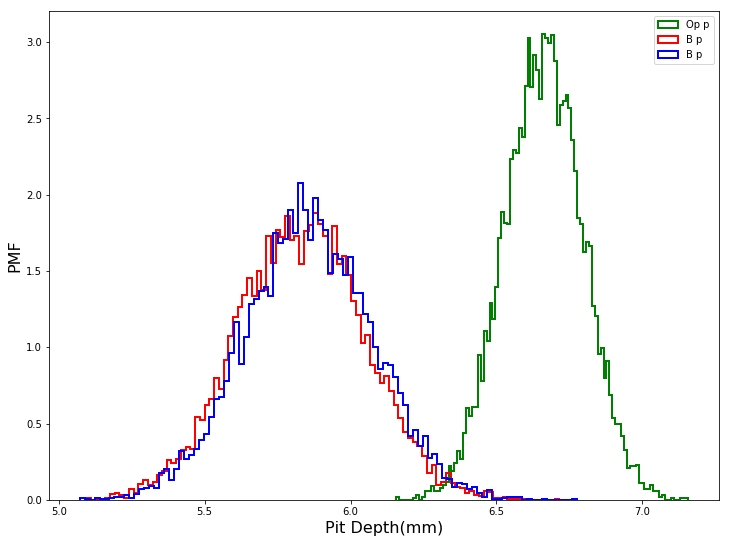

In [148]:
plt.figure(figsize=(12, 9))
plt.xlabel('Pit Depth(mm)', fontsize = 16)
plt.ylabel('PMF', fontsize = 16)
# bins_start_X_1 = np.int(np.min([np.min(Initiation_1_Actual_Depth[0]), np.min(X_1[0])]))
# bins_end_X_1   = np.int(np.max([np.max(Initiation_1_Actual_Depth[0]), np.max(X_1[0])]))
plt.hist(OperPressSamples[80], 100, color = 'green', \
         histtype='step', normed=True, linewidth=2, label='Op p');
plt.hist(BurstPressSamples[80], 100, color = 'red', \
         histtype='step', normed=True, linewidth=2, label='B p');
plt.hist(BurstPressSamples[10], 100, color = 'blue', \
         histtype='step', normed=True, linewidth=2, label='B p');

# plt.hist(RupturePressSamples[80], 100, color = 'blue', \
#          histtype='step', normed=True, linewidth=2, label='R p');

# plt.xlim(bins_start_X_1, 30)
plt.title('' , fontsize = 16)
plt.legend(loc='upper right')

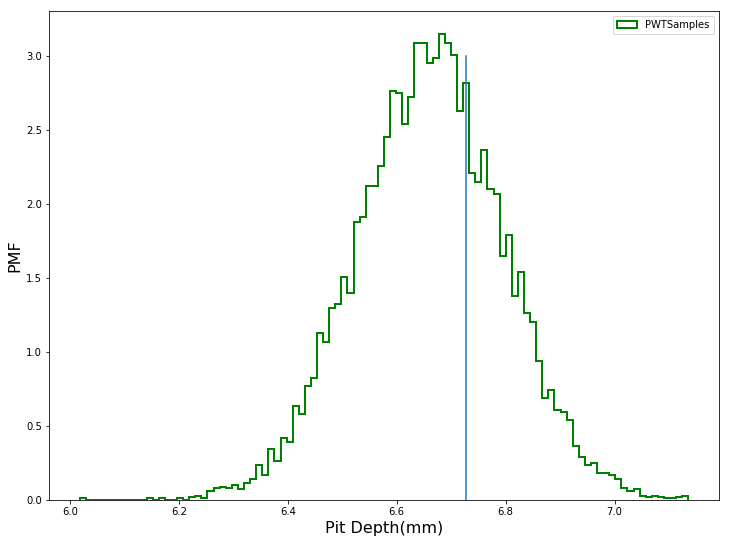

In [154]:
plt.figure(figsize=(12, 9))
plt.xlabel('Pit Depth(mm)', fontsize = 16)
plt.ylabel('PMF', fontsize = 16)
# bins_start_X_1 = np.int(np.min([np.min(Initiation_1_Actual_Depth[0]), np.min(X_1[0])]))
# bins_end_X_1   = np.int(np.max([np.max(Initiation_1_Actual_Depth[0]), np.max(X_1[0])]))
plt.hist(PWTSamples[1], 100, color = 'green', \
         histtype='step', normed=True, linewidth=2, label='PWTSamples');
plt.plot([small_leak_threshold,small_leak_threshold],[0,3])

# plt.hist(RupturePressSamples[80], 100, color = 'blue', \
#          histtype='step', normed=True, linewidth=2, label='R p');

# plt.xlim(bins_start_X_1, 30)
plt.title('' , fontsize = 16)
plt.legend(loc='upper right')

In [47]:
################################################################################################################
# similarity based on inspection results
similarity_1 = np.zeros(pit_No_ILI + 1)
for i in range (1, pit_No_ILI + 1):
    similarity_sum  = 0
    for j in range(0, ILI_no):
        for k in range(0, len(OLI_time)):
            if OLI_time[k]==ILI_time[j]:               
                A = estimated_mean_depth_HB.loc[i][j + 1]/ mean_estimated_depth_OLI_M[k]              
        similarity_sum = similarity_sum + A
    similarity_1[i] = similarity_sum / ILI_no     


In [48]:
dummy_obser_1 = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(0,OLI_no+1)).astype(float)

for i in range(1, pit_No_ILI+1):
    for j in range(0,OLI_no+1):
        dummy_obser_1.loc[i][j] = avail_OLI_data.loc[pit_M_no][j]*similarity_1[i]


In [49]:
# APF for ILI pits based on similarity_1
np.random.seed(seed_number)
start_time = time.time()

degradation_level_min  = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(OLI_time))).astype(float)
degradation_level_max  = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(OLI_time))).astype(float)
degradation_level_mean = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(len(OLI_time))).astype(float)

#mean_estimated_depth_OLI = np.zeros(len(OLI_time))
#mean_estimated_depth_OLI[0] = np.average(P)

TTF = pd.DataFrame(0, index=range(1,pit_No_ILI+1), columns=range(1)).astype(float)
TTF_is_calculated = pd.DataFrame(False, index=range(1,pit_No_ILI+1), columns=range(1)).astype(bool)
for i in range(1, pit_No_ILI+1): 
#for i in range(1, 3): 
    P, all_particle_OLI_time, k_p, nu_p, k_p_mean, nu_p_mean, k_p_var, nu_p_var,  w, p_data = initial_condition (0.6, 0.6)
    #mean_estimated_depth_OLI[0] = np.average(P)
    degradation_level_min.loc[i][0]  = np.min(P)
    degradation_level_max.loc[i][0]  = np.max(P)
    degradation_level_mean.loc[i][0] = np.mean(P)
    for j in tqdm(range(1,OLI_no+1)):
        k_p, nu_p = kernel_location ()     
        P = move(P,j,OLI_time,OLI_time_step) 
        k_p  = k_p  + np.random.normal(0, h**2 * k_p_var)    # size of random generation is given in m_k dimension that is num_particles
        nu_p = nu_p + np.random.normal(0, h**2 * nu_p_var) 
        P, k_p, nu_p = resample(P, k_p, nu_p, dummy_obser_1.loc[i][j])
        k_p_mean = np.mean (k_p)
        k_p_var = np.var(k_p)    
        nu_p_mean = np.mean (nu_p)         
        nu_p_var = np.var(nu_p)
        # Get the mean:
        #mean_estimated_depth_OLI[j] = np.average(P)
        #push_notebook(handle=t)
        time.sleep(0.01)
        #all_particle_OLI_time[:,i] = P
        #print (i)
        #print (np.percentile(P, 50))
        if np.percentile(P, Accepted_Probability_of_failure) > small_leak_threshold and TTF_is_calculated.loc[i].bool() == False:
            print (i)
            TTF.loc[i] = OLI_time[j]
            print ( TTF.loc[i])
            TTF_is_calculated.loc[i] = True
        degradation_level_min.loc[i][j]  = np.min(P)
        degradation_level_max.loc[i][j]  = np.max(P)
        degradation_level_mean.loc[i][j] = np.mean(P)
        #   print (OLI_time[j])     
        #show_particles()

    # Prediction phase for pit x
    # moving particles is done in this step for prediction without updating the weights of particles bcz there is no observations
    for j in tqdm(range(OLI_no , len(OLI_time))):
        P = move(P,j,OLI_time,OLI_time_step)  
        p_data.data['t'] = np.full(P.shape,OLI_time[j])
        p_data.data['y'] = P 
        # Get the mean:
        #mean_estimated_depth_OLI[j] = np.average(P)
        #push_notebook(handle=t)
        time.sleep(0.05)
        #all_particle_OLI_time[:,i] = P
        #print (i)
        #print (np.percentile(P, 50))
        if np.percentile(P, Accepted_Probability_of_failure) > small_leak_threshold and TTF_is_calculated.loc[i].bool() == False:
            print (i)
            TTF.loc[i] = OLI_time[j]
            print ( TTF.loc[i])
            TTF_is_calculated.loc[i] = True
        degradation_level_min.loc[i][j]  = np.min(P)
        degradation_level_max.loc[i][j]  = np.max(P)
        degradation_level_mean.loc[i][j] = np.mean(P)
        #    print (OLI_time[j])     
        #show_particles()
    #mean_estimated_depth_dummy_OLI_1.loc[i] = mean_estimated_depth_OLI
p1 = figure(title = 'Augmented PF, predcition for pit M using OLI, measurement error= '+ str(OLI_percent_error) +"% PWT", x_axis_label='t (year)', y_axis_label='depth (mm)'\
            , plot_height = 700, plot_width = 700)
p1.line(growing_time, pit_depth_OLI.loc [pit_M_no] , legend ='Real depth', color = 'green')
p1.triangle(OLI_time [:OLI_no], avail_OLI_data.loc [pit_M_no], size=5, legend ='OLI  for pit M', color = 'green')
#p1.line(OLI_time, mean_estimated_depth_OLI, legend ='Real depth', color = 'blue')
#p1.circle(OLI_time, mean_estimated_depth_OLI_M, radius=0.2, alpha = 0.2, color = 'blue', legend = 'Mean estimated depth for pit M by APF')
#p1.line(OLI_time, depth_x_OLI, color = 'red', legend = 'Real depth of pit x by ILI')
#p1.circle(ILI_time [:ILI_no], obs_M_ILI, radius=0.2, legend ='Observed depth of pit M by ILI', color = 'green')
#p1.circle(ILI_time [:ILI_no], obs_x_ILI, radius = 0.2, color = 'red', legend = 'Observed depth of pit x by ILI')

p1.legend.location='top_left'
#show(p1)
TTF
elapsed_time = time.time() - start_time    
elapsed_time

1
0    2076.4
Name: 1, dtype: float64



2
0    2057.2
Name: 2, dtype: float64



3
0    2093.4
Name: 3, dtype: float64



4
0    2091.1
Name: 4, dtype: float64



5
0    2069.8
Name: 5, dtype: float64



6
0    2069.8
Name: 6, dtype: float64



7
0    2076.0
Name: 7, dtype: float64



8
0    2060.2
Name: 8, dtype: float64



9
0    2072.7
Name: 9, dtype: float64



10
0    2099.9
Name: 10, dtype: float64



12
0    2072.9
Name: 12, dtype: float64



13
0    2064.0
Name: 13, dtype: float64



14
0    2075.2
Name: 14, dtype: float64



15
0    2081.9
Name: 15, dtype: float64



16
0    2067.2
Name: 16, dtype: float64



17
0    2055.9
Name: 17, dtype: float64



18
0    2077.9
Name: 18, dtype: float64



19
0    2089.2
Name: 19, dtype: float64



20
0    2088.0
Name: 20, dtype: float64



21
0    2080.3
Name: 21, dtype: float64



22
0    2073.9
Name: 22, dtype: float64



23
0    2084.9
Name: 23, dtype: float64



24
0    2073.9
Name: 24, dtype: float64



25
0    2064.7
Name: 25, dtype: float64



26
0    2074.7
Name: 26, dtype: float64



27
0    2049.2
Name: 27, dtype: float64



28
0    2077.9
Name: 28, dtype: float64



30
0    2075.4
Name: 30, dtype: float64



31
0    2066.3
Name: 31, dtype: float64



32
0    2051.1
Name: 32, dtype: float64



33
0    2093.0
Name: 33, dtype: float64



34
0    2083.6
Name: 34, dtype: float64



35
0    2062.7
Name: 35, dtype: float64



36
0    2095.4
Name: 36, dtype: float64



37
0    2074.6
Name: 37, dtype: float64



38
0    2087.1
Name: 38, dtype: float64



39
0    2077.9
Name: 39, dtype: float64



40
0    2090.7
Name: 40, dtype: float64



41
0    2082.4
Name: 41, dtype: float64



42
0    2063.7
Name: 42, dtype: float64



43
0    2064.3
Name: 43, dtype: float64



44
0    2061.6
Name: 44, dtype: float64



46
0    2091.1
Name: 46, dtype: float64



47
0    2098.3
Name: 47, dtype: float64



48
0    2095.8
Name: 48, dtype: float64



49
0    2087.1
Name: 49, dtype: float64



50
0    2086.8
Name: 50, dtype: float64



51
0    2066.9
Name: 51, dtype: float64



53
0    2072.8
Name: 53, dtype: float64



54
0    2082.4
Name: 54, dtype: float64



56
0    2073.1
Name: 56, dtype: float64



57
0    2075.7
Name: 57, dtype: float64



58
0    2072.3
Name: 58, dtype: float64



59
0    2059.1
Name: 59, dtype: float64



61
0    2064.4
Name: 61, dtype: float64



62
0    2095.5
Name: 62, dtype: float64



63
0    2081.6
Name: 63, dtype: float64



64
0    2062.8
Name: 64, dtype: float64



65
0    2083.2
Name: 65, dtype: float64



66
0    2088.0
Name: 66, dtype: float64



67
0    2085.3
Name: 67, dtype: float64



68
0    2084.0
Name: 68, dtype: float64



69
0    2076.6
Name: 69, dtype: float64



70
0    2073.7
Name: 70, dtype: float64



71
0    2055.4
Name: 71, dtype: float64



72
0    2056.5
Name: 72, dtype: float64



73
0    2064.3
Name: 73, dtype: float64



74
0    2061.1
Name: 74, dtype: float64



75
0    2057.4
Name: 75, dtype: float64



76
0    2082.3
Name: 76, dtype: float64



77
0    2080.3
Name: 77, dtype: float64



78
0    2079.9
Name: 78, dtype: float64



79
0    2086.3
Name: 79, dtype: float64



80
0    2059.9
Name: 80, dtype: float64



81
0    2081.1
Name: 81, dtype: float64



82
0    2057.6
Name: 82, dtype: float64



83
0    2063.0
Name: 83, dtype: float64



84
0    2078.3
Name: 84, dtype: float64



86
0    2064.4
Name: 86, dtype: float64



87
0    2084.1
Name: 87, dtype: float64



88
0    2085.7
Name: 88, dtype: float64



89
0    2073.4
Name: 89, dtype: float64



90
0    2075.7
Name: 90, dtype: float64



91
0    2070.6
Name: 91, dtype: float64



92
0    2067.1
Name: 92, dtype: float64



93
0    2083.1
Name: 93, dtype: float64



94
0    2059.8
Name: 94, dtype: float64



95
0    2096.8
Name: 95, dtype: float64



96
0    2059.3
Name: 96, dtype: float64



97
0    2066.6
Name: 97, dtype: float64



98
0    2079.7
Name: 98, dtype: float64



100
0    2091.9
Name: 100, dtype: float64



21970.88381409645

In [50]:
###########################################################################################  
# plots
for i in range(1, pit_No_ILI+1):
    p = figure(title = 'Seed No. = ' + str(seed_number) + ', Similarity Index = ' + str(np.round(similarity_1[i],3)) + ', Pit No. '+str(i), x_axis_label='t (year)',\
               y_axis_label='Pit depth (mm)', plot_height = 700, plot_width = 700)
    p.xaxis.axis_line_width = 3
    p.xaxis.major_label_text_font_size = "15pt"
    p.yaxis.axis_line_width = 3 
    p.yaxis.major_label_text_font_size = "15pt"
    p.xaxis.axis_label_text_font_size  = "20pt"
    p.yaxis.axis_label_text_font_size  = "20pt"
    p.axis.minor_tick_in  = 2
    p.axis.minor_tick_out = 5
    p.axis.axis_label_text_alpha=0.9
    p.legend.label_text_font_size = "4pt"
    p.line(growing_time [0:850], pit_depth_ILI.loc [i] , legend ='Real maximum depth', color = 'red', line_width=2) 
    p.circle(ILI_time[0:ILI_no+1 ],avail_ILI_data.loc [i] ,radius=1.0,legend ='Measured maximum depth by ILI',color = 'red')
    p.circle(ILI_time[0:ILI_no+1 ],estimated_mean_depth_HB.loc [i] ,radius=1.0,legend ='Estimated depth by Maes model',color = 'blue')                 
    p.line(OLI_time[0:570], degradation_level_mean.loc[i], color = 'purple', legend = 'Mean estimated maximum depth by this framework', line_width=2)    
    p.line(OLI_time[0:570], degradation_level_min.loc[i], color = 'purple', line_dash = 'dashed', legend = 'Lower & Upper bounds of the estimated maximum depth', line_width=2)    
    p.line(OLI_time[0:570], degradation_level_max.loc[i], color = 'purple', line_dash = 'dashed', legend = 'Lower & Upper bounds of the estimated maximum depth', line_width=2)    
    p.legend.location='top_left'  
    show(p)

In [51]:
rms_HB

0.5187195623982178

In [52]:
# DF stands for data fusion
rms_DF_mean = sqrt(mean_squared_error(pit_depth_ILI.loc[:,Estimation_time_index],\
                              degradation_level_mean.loc [:,OLI_no]))
rms_DF_max = sqrt(mean_squared_error(pit_depth_ILI.loc[:,Estimation_time_index],\
                              degradation_level_max.loc [:,OLI_no]))
rms_DF_min = sqrt(mean_squared_error(pit_depth_ILI.loc[:,Estimation_time_index],\
                              degradation_level_min.loc [:,OLI_no]))
print(rms_DF_mean)
print(rms_DF_max)
print(rms_DF_min)

0.3222598999187742
0.31739684365662485
0.38370817003599517


In [53]:
print(rms_DF_mean/rms_HB)
print(rms_DF_max/rms_HB)
print(rms_DF_min/rms_HB)

0.6212603558440258
0.6118852394715765
0.7397218031685198


In [54]:
Framework_No = 0
HB_No = 0
dd = 0.1
for i in range(1, pit_No_ILI+1):
    if (1-dd) * pit_depth_ILI.loc[i,Estimation_time_index] < degradation_level_mean.loc  [i,OLI_no] \
    < (1 + dd) * pit_depth_ILI.loc[i,Estimation_time_index]:
        Framework_No = Framework_No + 1
    if (1-dd) * pit_depth_ILI.loc[i,Estimation_time_index] < estimated_mean_depth_HB.loc [i,ILI_no+1] \
    < (1 + dd) * pit_depth_ILI.loc[i,Estimation_time_index]:
        HB_No = HB_No + 1
print (Framework_No)
print (HB_No)


approx_TTF.to_csv('approx_TTF_' +str(seed_number)+'.csv',header=False, index=False, float_format='%.2f')
TTF.to_csv('TTF'+str(seed_number)+'.csv',header=False, index=False, float_format='%.2f')
import openpyxl
wbkName = 'Comparison.xlsx'
wbk = openpyxl.load_workbook(wbkName)
wks = wbk['Updated_moderate']

wks.cell(row=excel_row, column=9).value = np.round(rms_HB, 3)
wks.cell(row=excel_row, column=10).value = np.round(rms_DF_mean, 3)
wks.cell(row=excel_row, column=11).value = np.round(rms_DF_mean/rms_HB, 3)

wks.cell(row=excel_row, column=12).value = np.round(rms_DF_max, 3)
wks.cell(row=excel_row, column=13).value = np.round(rms_DF_max/rms_HB, 3)

wks.cell(row=excel_row, column=14).value = np.round(rms_DF_min, 3)
wks.cell(row=excel_row, column=15).value = np.round(rms_DF_min/rms_HB, 3)

wks.cell(row=excel_row, column=16).value = HB_No
wks.cell(row=excel_row, column=17).value = Framework_No
wks.cell(row=excel_row, column=18).value = Framework_No / HB_No


wbk.save(wbkName)
wbk.close


75
42


<bound method Workbook.close of <openpyxl.workbook.workbook.Workbook object at 0x000001D36EAD4128>>